In [1]:
# Add at the beginning of your notebook to make imports work
import sys
import os

# Get the absolute path to the project root directory (one level up from notebooks)
project_root = os.path.abspath(os.path.join(os.getcwd(), '..'))

# Add the project root to Python's import path if it's not already there
if project_root not in sys.path:
    sys.path.insert(0, project_root)
    print(f"Added {project_root} to Python path")

Added /Users/amber/Desktop/Simulation/Avail-Fusion-CryptoEcon to Python path


Running Avail Fusion simulation for 365 days...
###########################
timestep 0
[DEBUG] update_token_prices
{'avl_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=1.0, balance=9000000.0, price=0.1), 'ETH': AssetAllocation(pct=0.0, balance=0, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'eth_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, price=0.1), 'ETH': AssetAllocation(pct=1.0, balance=300, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'btc_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, price=0.1), 'ETH': AssetAllocation(pct=0.0, balance=0, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1)}
  AVL Flow: $33,314.00 (D: $238,770.33, W: $205,456.33)
  ETH

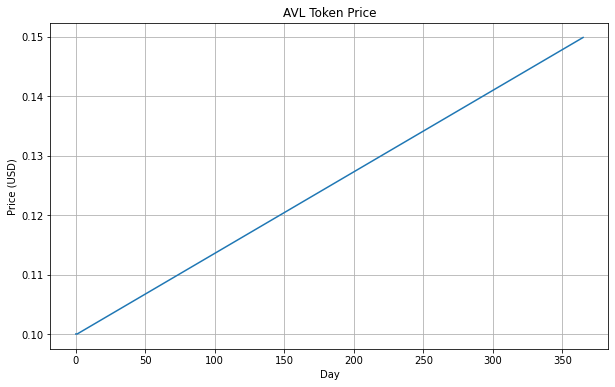

####### Yields #######


In [2]:
import scripts.simulation_runner as sim
import visualizations.comparison_plots as comp_plots


# Run a simulation with default parameters
results = sim.run_simulation()

# Visualize results
sim.plot_simulation_results(results)

<class 'float'>
<class 'float'>
<class 'float'>
<class 'float'>
Running Avail Fusion simulation for 365 days...
###########################
timestep 0
[DEBUG] update_token_prices
{'avl_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=np.float64(1.0), balance=9000000.0, price=np.float64(0.01)), 'ETH': AssetAllocation(pct=np.float64(0.0), balance=0, price=np.float64(1440.9005589074684)), 'BTC': AssetAllocation(pct=np.float64(0.0), balance=0, price=np.float64(81808.15201471717))}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'eth_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=np.float64(0.0), balance=0, price=np.float64(0.01)), 'ETH': AssetAllocation(pct=np.float64(1.0), balance=300, price=np.float64(1440.9005589074684)), 'BTC': AssetAllocation(pct=np.float64(0.0), balance=0, price=np.float64(81808.15201471717))}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'btc_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, pric

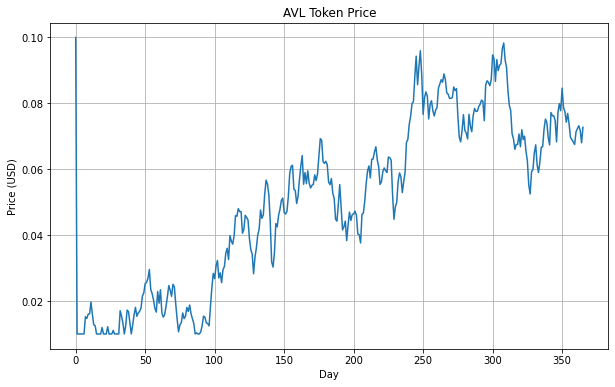

####### Yields #######


In [3]:
# Create a configuration using Brownian Motion for all assets
config = sim.SimulationConfig(
    # Basic simulation parameters
    simulation_days=365,
    
    # Initial prices
    avl_initial_price=0.05,
    eth_initial_price=1500,
    btc_initial_price=85000,
    lens_initial_price=1.0,
    
    # Use Brownian Motion price process
    price_process_type='BM',
    
    # AVL Brownian Motion parameters
    price_traj_type='convex',      # 'convex', 'concave', or 'none'
    minimum_price=0.01,            # Minimum possible price
    maximum_price=0.5,             # Maximum possible price
    target_avg_price=0.05,          # Target average price across simulation
    bm_volatility=1.2,             # Controls randomness (higher = more volatile)
    
    # ETH Brownian Motion parameters
    eth_price_traj_type='convex', # Different trend type for ETH
    eth_minimum_price=1200,        # ETH-specific price floor
    eth_maximum_price=2500,        # ETH-specific price ceiling
    eth_target_avg_price=1600,     # Target average ETH price
    eth_bm_volatility=0.8,         # Lower volatility for ETH
    
    # BTC Brownian Motion parameters
    btc_price_traj_type='convex',    # Pure random walk for BTC
    btc_minimum_price=70000,       # BTC-specific price floor
    btc_maximum_price=100000,      # BTC-specific price ceiling  
    btc_target_avg_price=85000,    # Target average BTC price
    btc_bm_volatility=0.6,         # Even lower volatility for BTC
    
    # LENS Brownian Motion parameters (optional)
    lens_price_traj_type='convex',
    lens_minimum_price=0.8,
    lens_maximum_price=1.5,
    lens_target_avg_price=1.1,
    lens_bm_volatility=1.0,
    
    # Other parameters
    restaking=1.0
)

# Run simulation with Brownian Motion price model for all assets
results = sim.run_simulation(config)
sim.plot_simulation_results(results)

In [4]:
# Base configuration
base_config = sim.SimulationConfig(restaking=1.0, avl_price_growth=-0.9)

# Define comparison configurations
comparisons = [
    {'restaking': 1.0, "avl_price_growth":-0.7},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":-0.5},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":-0.3},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":-0.1},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.0},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.1},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.3},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.5},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.7},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.9},   # 100% restaking
]

# Run comparisons
results = sim.compare_simulations(
    base_config=base_config,
    comparison_configs=comparisons,
    names=["Down 90%", "Down 70%", "Down 50%", "Down 30%", "Down 10%", "No change", "Up 10%", "Up 30%", "Up 50%", "Up 70%", "Up 90%"],
)

# Access individual results
for name, df in results.items():
    print(f"Results for {name}:")

Running Down 90% (base simulation)...
Running Avail Fusion simulation for 365 days...
###########################
timestep 0
[DEBUG] update_token_prices
{'avl_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=1.0, balance=9000000.0, price=0.1), 'ETH': AssetAllocation(pct=0.0, balance=0, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'eth_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, price=0.1), 'ETH': AssetAllocation(pct=1.0, balance=300, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'btc_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, price=0.1), 'ETH': AssetAllocation(pct=0.0, balance=0, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1)}
  AVL Flow: $33,314.00 

In [5]:
results['Down 90%']

,timestep,agents,pool_manager,target_yields,total_security,tvl,staked_token_balances,total_fdv,staking_ratio_all,staking_ratio_fusion,...,total_annual_inflation_rewards_in_avl,total_annual_inflation_rewards_usd,yield_pcts,avg_yield,compounding_yield_pcts,compounding_avg_yield,simulation,subset,run,substep
0,0,{'avl_maxi': AgentStake(assets={'AVL': AssetAl...,"PoolManager(total_budget=30000000000.0, pools=...","{'AVL': 0.15, 'ETH': 0.035}",0.000000e+00,{},"{'AVL': 9000000.0, 'ETH': 300, 'BTC': 0}",1.000000e+09,0.500000,"{'AVL': 0, 'ETH': 0}",...,5.000000e+08,5.000000e+07,"{'avl_maxi': 0, 'eth_maxi': 0, 'btc_maxi': 0}",0.000000,{},0.000000,0,0,1,0
1,1,{'avl_maxi': AgentStake(assets={'AVL': AssetAl...,"PoolManager(total_budget=30000000000.0, pools=...","{'AVL': 0.15, 'ETH': 0.035}",0.000000e+00,{},"{'AVL': 9000000.0, 'ETH': 300, 'BTC': 0}",1.000000e+09,0.500000,"{'AVL': 0, 'ETH': 0}",...,5.000000e+08,5.000000e+07,"{'avl_maxi': 0, 'eth_maxi': 0, 'btc_maxi': 0}",0.000000,{},0.000000,0,0,1,1
2,1,{'avl_maxi': AgentStake(assets={'AVL': AssetAl...,"PoolManager(total_budget=30000000000.0, pools=...","{'AVL': 0.15, 'ETH': 0.035}",0.000000e+00,{},"{'AVL': 9000000.0, 'ETH': 300, 'BTC': 0}",1.000000e+09,0.500000,"{'AVL': 0, 'ETH': 0}",...,5.000000e+08,5.000000e+07,"{'avl_maxi': 0, 'eth_maxi': 0, 'btc_maxi': 0}",0.000000,{},0.000000,0,0,1,2
3,1,{'avl_maxi': AgentStake(assets={'AVL': AssetAl...,"PoolManager(total_budget=30000000000.0, pools=...","{'AVL': 0.15, 'ETH': 0.035}",1.408095e+06,"{'AVL': 933314.002748623, 'ETH': 474781.042032...","{'AVL': 9333140.02748623, 'ETH': 316.520694688...",1.000000e+09,0.500933,"{'AVL': 0.662820316148359, 'ETH': 0.3371796838...",...,5.000000e+08,5.000000e+07,"{'avl_maxi': 0, 'eth_maxi': 0, 'btc_maxi': 0}",0.000000,{},0.000000,0,0,1,3
4,1,{'avl_maxi': AgentStake(assets={'AVL': AssetAl...,"PoolManager(total_budget=30000000000.0, pools=...","{'AVL': 0.15, 'ETH': 0.035}",1.408095e+06,"{'AVL': 933314.002748623, 'ETH': 474781.042032...","{'AVL': 9333140.02748623, 'ETH': 316.520694688...",1.000000e+09,0.500933,"{'AVL': 0.662820316148359, 'ETH': 0.3371796838...",...,4.948579e+08,4.948579e+07,"{'avl_maxi': 0, 'eth_maxi': 0, 'btc_maxi': 0}",0.000000,{},0.000000,0,0,1,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3281,365,{'avl_maxi': AgentStake(assets={'AVL': AssetAl...,"PoolManager(total_budget=33000000000.0, pools=...","{'AVL': 0.15, 'ETH': 0.035, 'BTC': 0.05}",7.318165e+07,"{'BTC': 41045703.733270966, 'AVL': 20421930.97...","{'BTC': 482.890632156129, 'AVL': 1993049413.64...",1.024658e+08,0.694622,"{'AVL': 0.2790580967178399, 'ETH': 0.160067616...",...,1.269353e+08,1.300652e+06,"{'avl_maxi': 15.0, 'eth_maxi': 3.5740495377189...",7.598631,"{'avl_maxi': 15.765192931703012, 'eth_maxi': 3...",8.223505,0,0,1,5
3282,365,{'avl_maxi': AgentStake(assets={'AVL': AssetAl...,"PoolManager(total_budget=33000000000.0, pools=...","{'AVL': 0.15, 'ETH': 0.035, 'BTC': 0.05}",7.318165e+07,"{'BTC': 41045703.733270966, 'AVL': 20421930.97...","{'BTC': 482.890632156129, 'AVL': 1993049413.64...",1.024658e+08,0.694622,"{'AVL': 0.2790580967178399, 'ETH': 0.160067616...",...,1.269353e+08,1.300652e+06,"{'avl_maxi': 15.0, 'eth_maxi': 3.5740495377189...",7.598631,"{'avl_maxi': 15.765192931703012, 'eth_maxi': 3...",8.223505,0,0,1,6
3283,365,{'avl_maxi': AgentStake(assets={'AVL': AssetAl...,"PoolManager(total_budget=33000000000.0, pools=...","{'AVL': 0.15, 'ETH': 0.035, 'BTC': 0.05}",7.318165e+07,"{'BTC': 41045703.733270966, 'AVL': 20421930.97...","{'BTC': 482.890632156129, 'AVL': 1993049413.64...",1.024658e+08,0.694622,"{'AVL': 0.2790580967178399, 'ETH': 0.160067616...",...,1.269353e+08,1.300652e+06,"{'avl_maxi': 15.000000000000002, 'eth_maxi': 3...",7.550480,"{'avl_maxi': 15.765192931703012, 'eth_maxi': 3...",8.223505,0,0,1,7
3284,365,{'avl_maxi': AgentStake(assets={'AVL': AssetAl...,"PoolManager(total_budget=33000000000.0, pools=...","{'AVL': 0.15, 'ETH': 0.035, 'BTC': 0.05}",7.318165e+07,"{'BTC': 41045

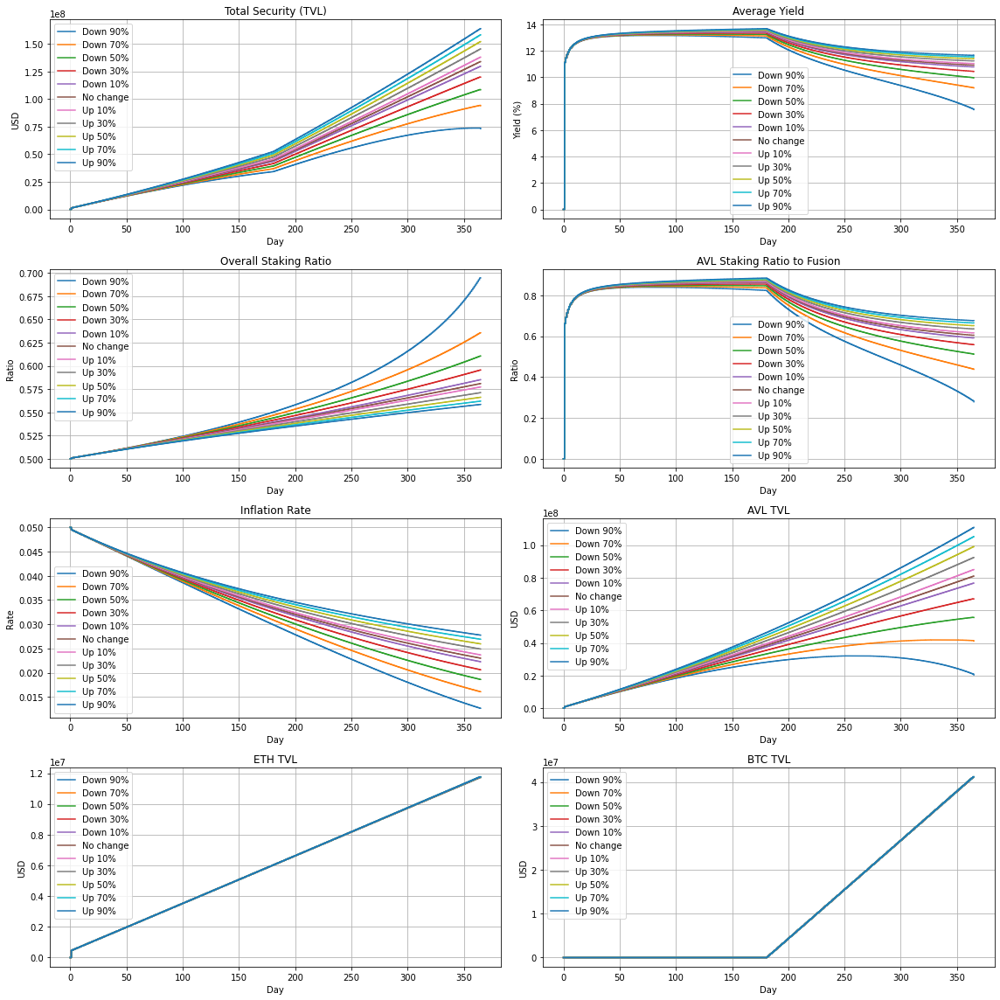

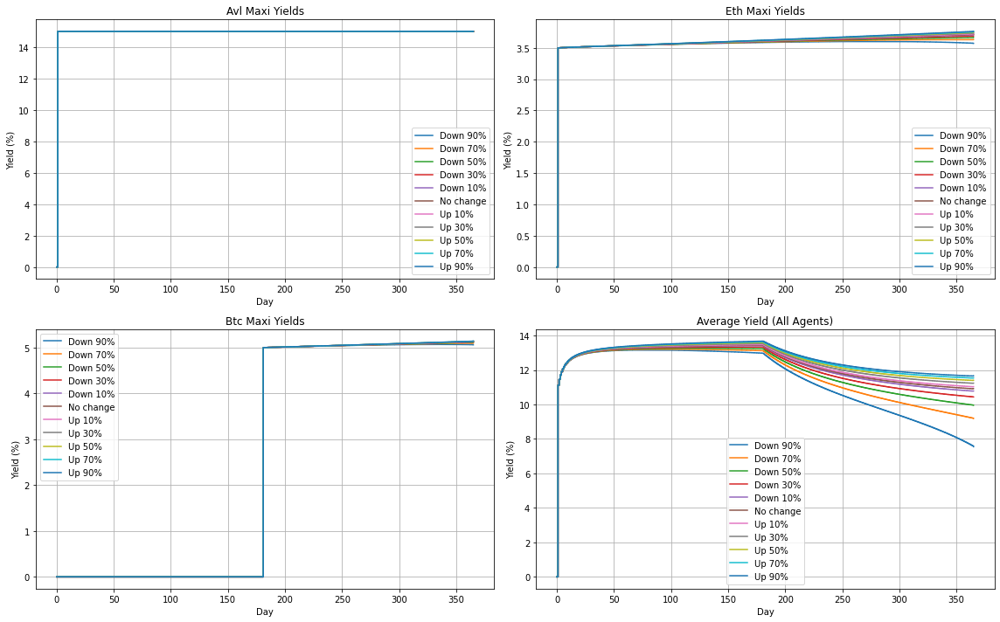

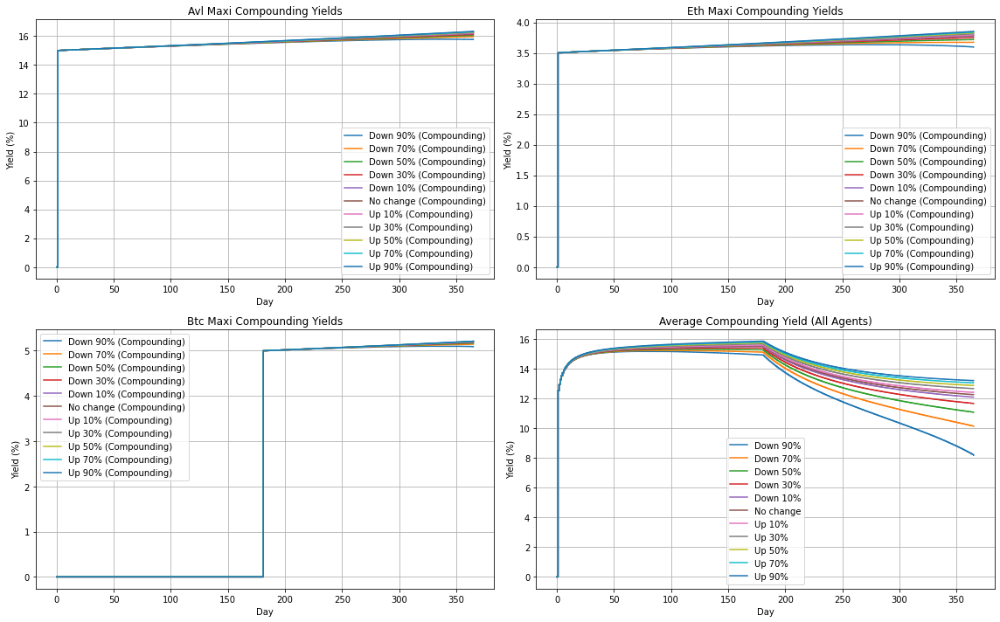

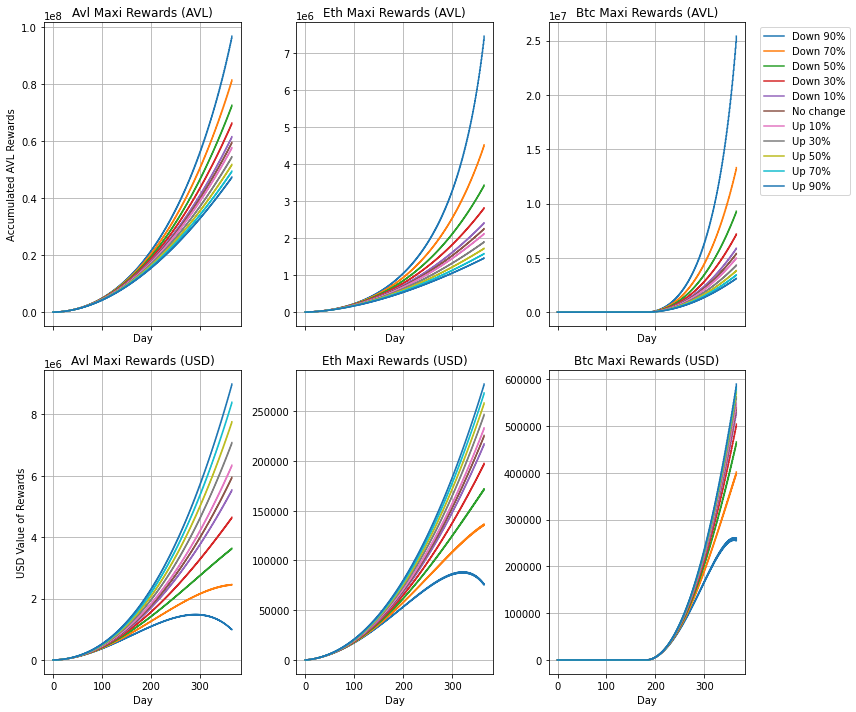

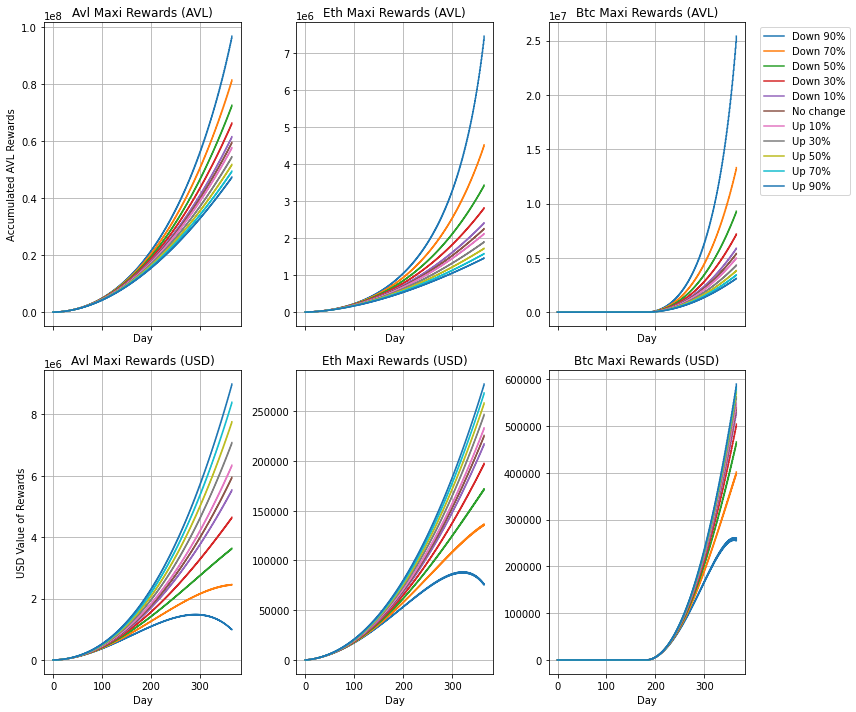

In [6]:


# Create a comprehensive dashboard comparing all scenarios
comp_plots.plot_comparison_dashboard(results)

# Compare yields across scenarios
comp_plots.plot_yields_comparison(results)

# Compare accumulated rewards
comp_plots.plot_rewards_comparison(results)

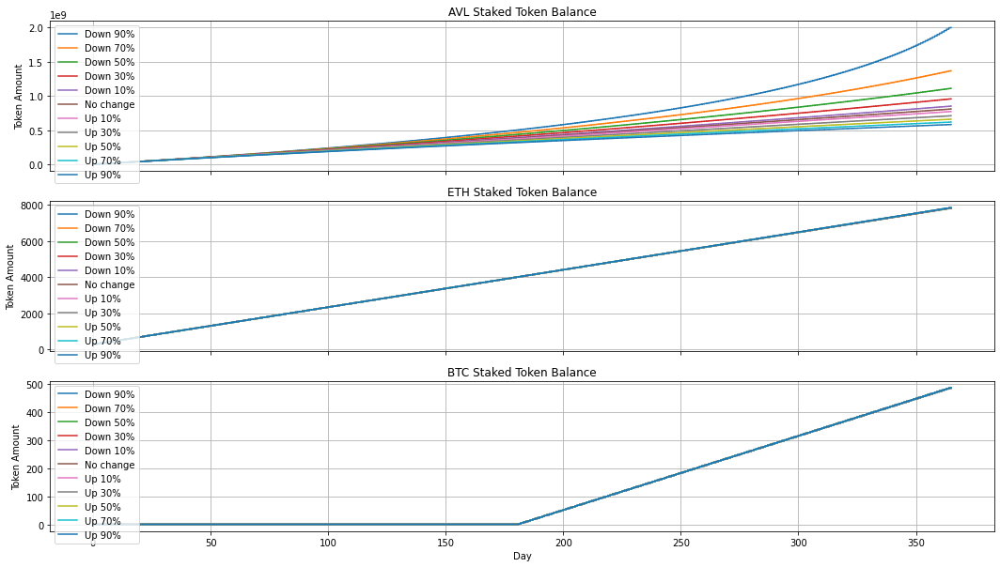

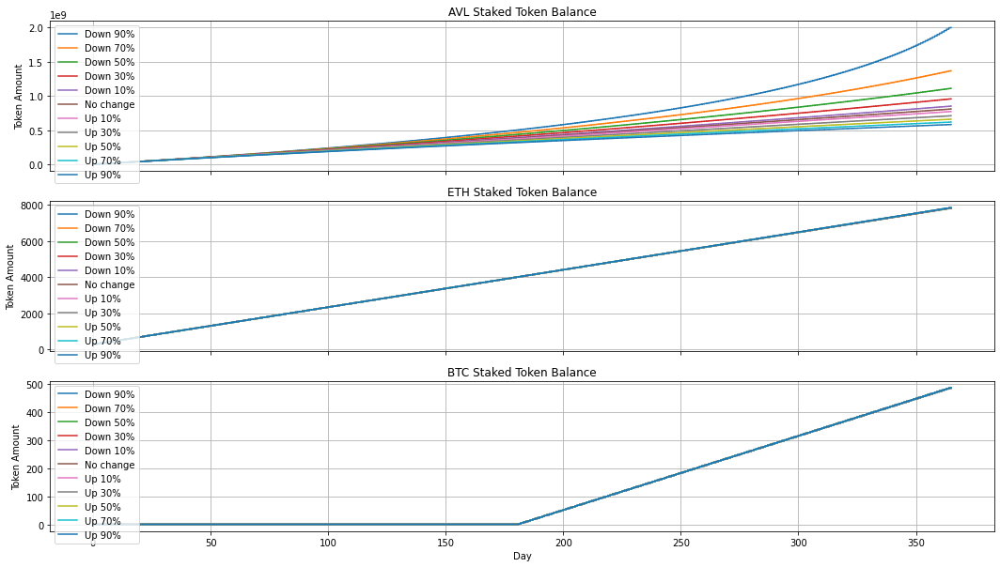

In [7]:
comp_plots.plot_staked_token_balances_comparison(
    scenarios=results,  # Or multiple scenarios
    assets=["AVL", "ETH", "BTC"]  # Optional - specify which assets to plot
)

In [8]:
# # Base configuration
# base_config = sim.SimulationConfig(restaking=1.0, avl_price_growth=-0.9)

# # Define comparison configurations
# comparisons = [
#     {'restaking': 0, "avl_price_growth":-0.9},   # 100% restaking
#     {'restaking': 1.0, "avl_price_growth":-0.5},   # 100% restaking
#     {'restaking': 0, "avl_price_growth":-0.5},   # 100% restaking
#     {'restaking': 1.0, "avl_price_growth":-0.1},   # 100% restaking
#     {'restaking': 0, "avl_price_growth":-0.1},   # 100% restaking
#     {'restaking': 1.0, "avl_price_growth":0.1},   # 100% restaking
#     {'restaking': 0, "avl_price_growth":0.1},   # 100% restakingå
#     {'restaking': 1.0, "avl_price_growth":0.5},   # 100% restaking
#     {'restaking': 0, "avl_price_growth":0.5},   # 100% restaking
#     {'restaking': 1.0, "avl_price_growth":0.9},   # 100% restaking
#     {'restaking': 0, "avl_price_growth":0.9},   # 100% restaking
# ]

# # Run comparisons
# results = sim.compare_simulations(
#     base_config=base_config,
#     comparison_configs=comparisons,
#     names=["Restake, Down 90%", "Unrestake, Down 90%", 
#            "Restake, Down 50%", "Unrestake, Down 50%", 
#            "Restake, Down 10%", "Unrestake, Down 10%", 
#            "Restake, Up 10%", "Unrestake, Up 10%", 
#            "Restake, Up 50%", "Unrestake, Up 50%",
#            "Restake, Up 90%", "Unrestake, Up 90%"],
# )

# # Access individual results
# for name, df in results.items():
#     print(f"Results for {name}:")

In [9]:
# Base configuration
base_config = sim.SimulationConfig(restaking=1.0, avl_price_growth=-0.9, simulation_days=365*2)

# Define comparison configurations
comparisons = [
    {'restaking': 1.0, "avl_price_growth":-0.5, "simulation_days":365*2},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":-0.1, "simulation_days":365*2},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.0, "simulation_days":365*2 },   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.1, "simulation_days":365*2},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.5, "simulation_days":365*2},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.9, "simulation_days":365*2},   # 100% restaking
]

# Run comparisons
results = sim.compare_simulations(
    base_config=base_config,
    comparison_configs=comparisons,
    names=["Down 90%",  "Down 50%", "Down 10%", "No change", "Up 10%", "Up 50%","Up 90%"],
)

# Access individual results
for name, df in results.items():
    print(f"Results for {name}:")

Running Down 90% (base simulation)...
Running Avail Fusion simulation for 730 days...
###########################
timestep 0
[DEBUG] update_token_prices
{'avl_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=1.0, balance=9000000.0, price=0.1), 'ETH': AssetAllocation(pct=0.0, balance=0, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'eth_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, price=0.1), 'ETH': AssetAllocation(pct=1.0, balance=300, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'btc_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, price=0.1), 'ETH': AssetAllocation(pct=0.0, balance=0, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1)}
  AVL Flow: $33,314.00 

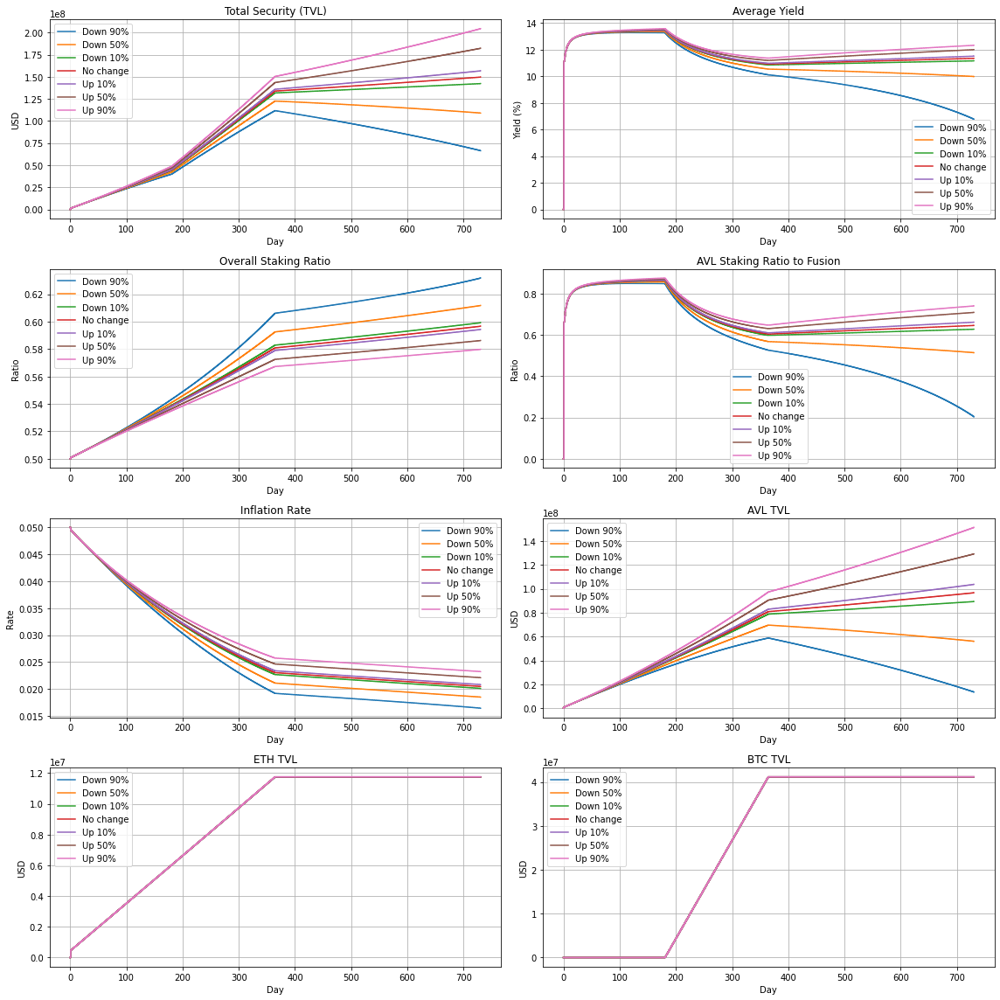

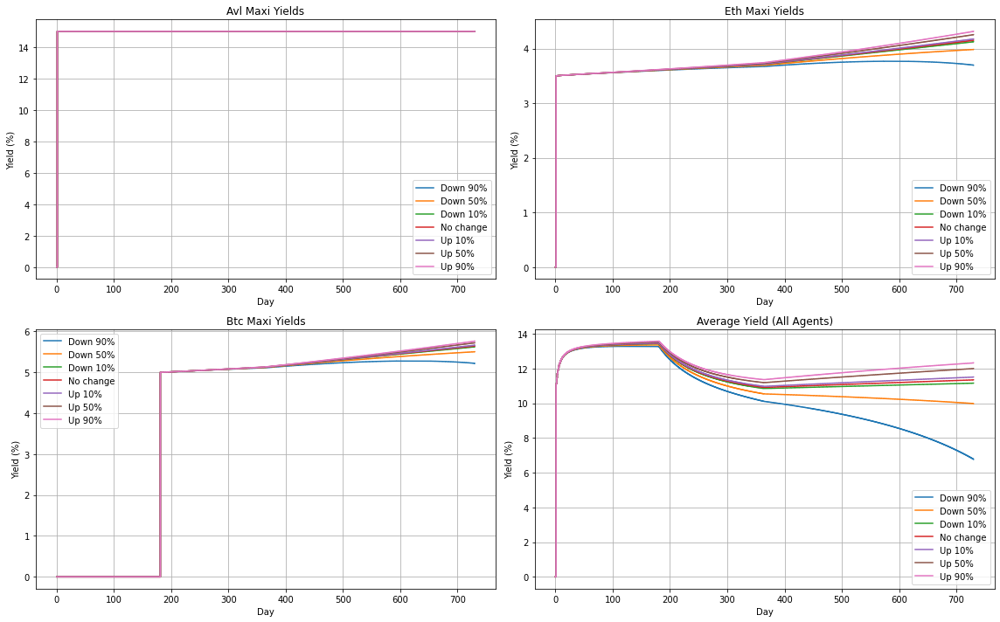

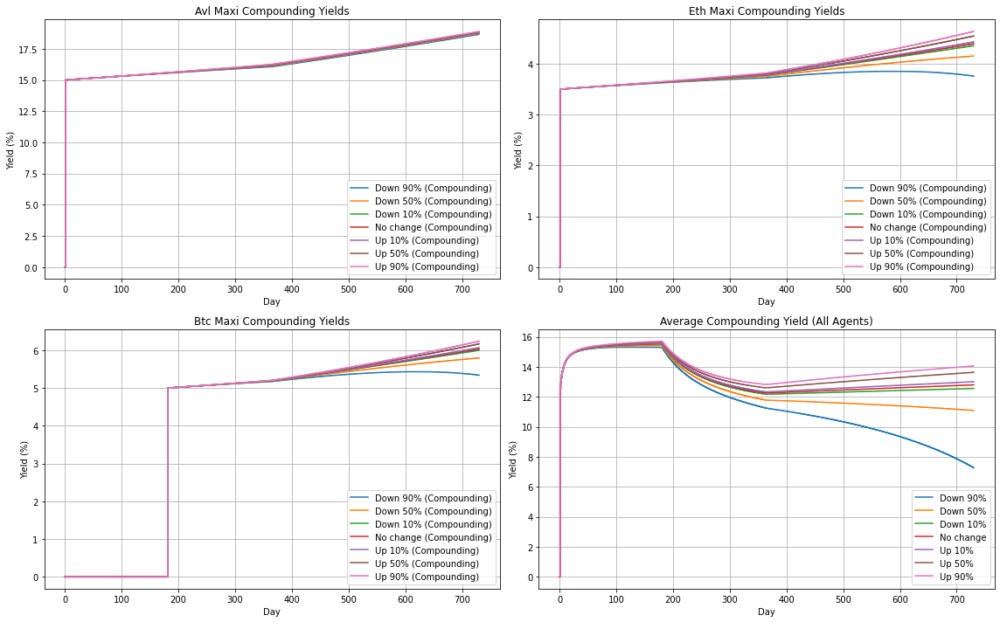

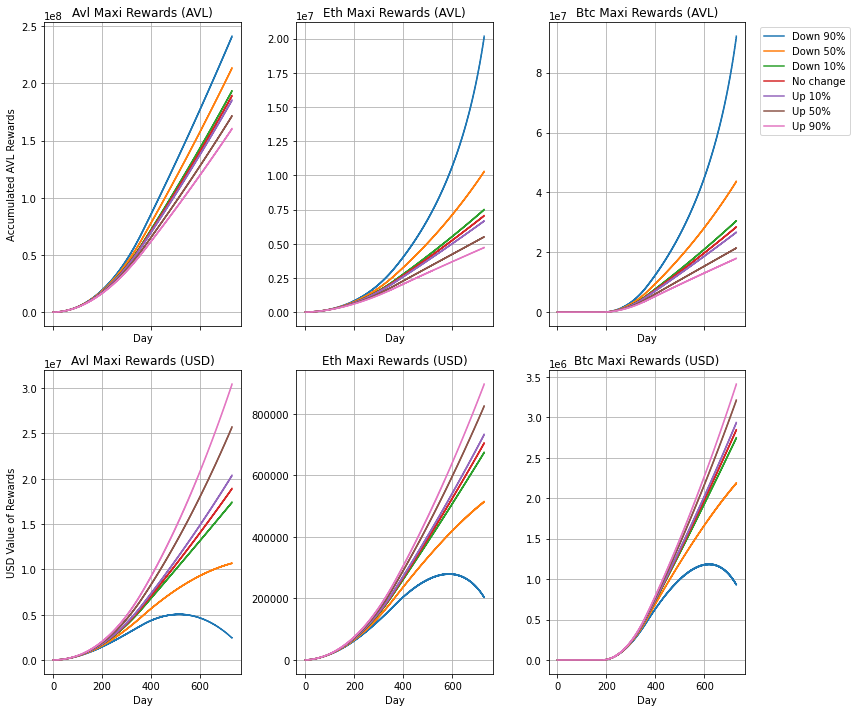

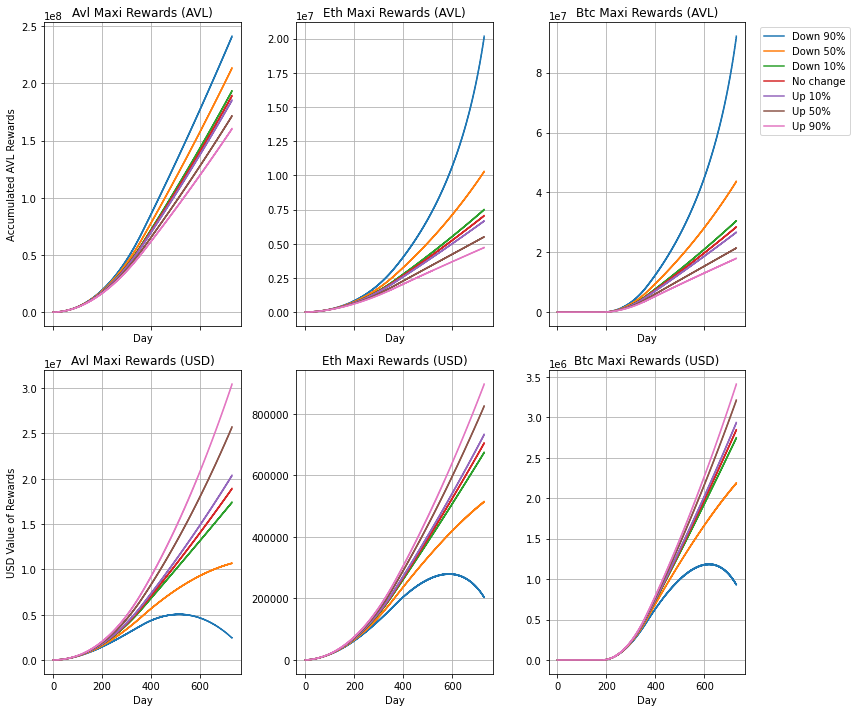

In [10]:
# Create a comprehensive dashboard comparing all scenarios
comp_plots.plot_comparison_dashboard(results)

# Compare yields across scenarios
comp_plots.plot_yields_comparison(results)

# Compare accumulated rewards
comp_plots.plot_rewards_comparison(results)